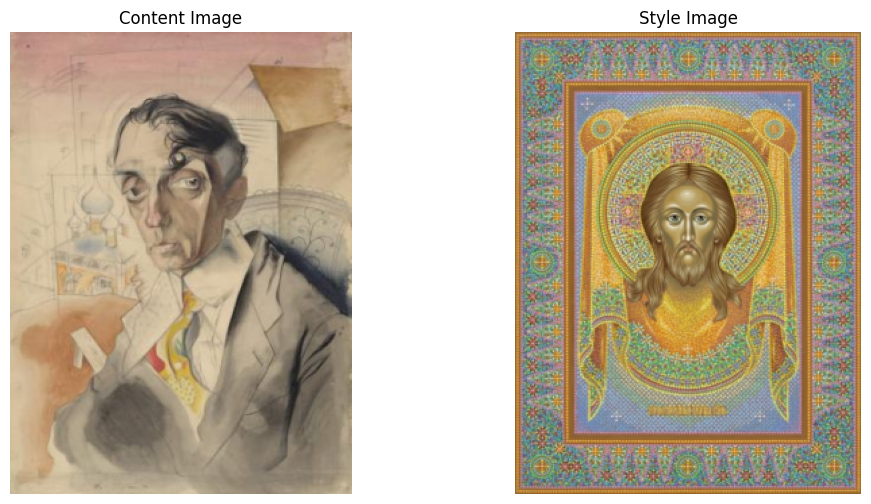

100%|██████████| 150/150 [01:22<00:00,  1.82it/s]


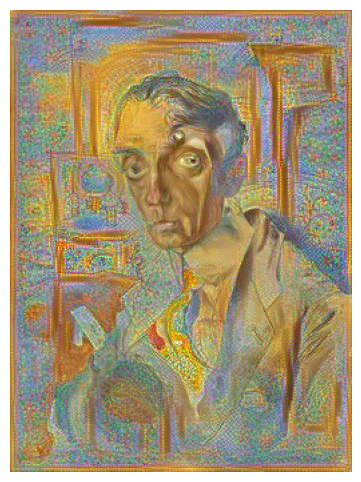

In [27]:
import torch
import torch.optim as optim
from torchvision import models, transforms
from PIL import Image
import matplotlib.pyplot as plt
from tqdm import tqdm
from IPython.display import HTML
import matplotlib.animation as animation
from torchvision.models import VGG16_Weights


# The tensor should be multiplied by the std dev and then add the mean
def im_convert(tensor):
    tensor = tensor.clone().detach().cpu().squeeze(0)
    # Denormalize: (image * std + mean)
    image = tensor * torch.Tensor([0.229, 0.224, 0.225]).view(3, 1, 1)
    image = image + torch.Tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
    image = image.numpy().transpose(1, 2, 0)
    image = image.clip(0, 1)
    return image


# Load and preprocess an image
def load_image(image_path):
    image = Image.open(image_path)
    image = preprocess(image).unsqueeze(0)  # Add batch dimension
    return image.to(device)


# Function to get content and style features
def get_features(image, model, layers=None):
    if layers is None:
        layers = {
            '0': 'conv1_1', '5': 'conv2_1', '10': 'conv3_1', 
            '19': 'conv4_1', '21': 'conv4_2', '28': 'conv5_1'
        }
    features = {}
    x = image
    for name, layer in model._modules.items():
        x = layer(x)
        if name in layers:
            features[layers[name]] = x
    return features

# Calculate Gram Matrix for style representation
def gram_matrix(tensor):
    _, d, h, w = tensor.size()
    tensor = tensor.view(d, h * w)
    gram = torch.mm(tensor, tensor.t())
    return gram


# Define loss function
def compute_loss(target_features, content_features, style_grams):
    # Content Loss
    content_loss = 0
    for layer in content_layers:
        layer_content_loss = torch.mean((target_features[layer] - content_features[layer]) ** 2)
        content_loss += layer_content_loss / len(content_layers)
    # Style Loss
    style_loss = 0
    for layer in style_layers:
        target_gram = gram_matrix(target_features[layer])
        style_gram = style_grams[layer]
        layer_style_loss = torch.mean((target_gram - style_gram) ** 2)
        style_loss += layer_style_loss / len(style_layers)

    total_loss = content_weight * content_loss + style_weight * style_loss
    return total_loss


# if lbfgs optimizer is used this function is uswed for step
def closure():
        optimizer.zero_grad()
        target_features = get_features(target, vgg)
        loss = compute_loss(target_features, content_features, style_grams)
        loss.backward()
        return loss


    


# Set device to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Preprocess images for VGG16 input
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
# Define loss weights
style_weight = 0.000003
content_weight = 1

# Define layers
style_layers = ['conv1_1', 'conv2_1', 'conv3_1', 'conv4_1']
content_layer = ['conv4_1']
# content_layers = ['conv1_1', 'conv2_1', 'conv3_1', 'conv4_1']

# Choose optimizer
use_lbfgs = True

rootPath = '/kaggle/input/art-images-drawings-painting-sculpture-engraving/dataset/dataset_updated/training_set/'
# Load images
content_image = load_image(rootPath+"drawings/3389_mainfoto_05.jpg")
style_image = load_image(rootPath+"iconography/105.jpg")

# Extract features for content and style (GROUND TRUTH)
content_features = get_features(content_image, vgg)
style_features = get_features(style_image, vgg)
# Compute Gram matrices for style layers
style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}

#plotting the content and style image for reference
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
# Plot content image
axes[0].imshow(im_convert(content_image))
axes[0].set_title('Content Image')
axes[0].axis('off')  # Hide axes for a cleaner display
# Plot style image
axes[1].imshow(im_convert(style_image))
axes[1].set_title('Style Image')
axes[1].axis('off')  # Hide axes for a cleaner display
plt.show()



# Load pretrained VGG16 model
vgg = models.vgg16(weights=VGG16_Weights.DEFAULT).features.to(device)
vgg.eval()
# Freeze parameters of VGG16
for param in vgg.parameters():
    param.requires_grad = False

# Random Initialize of the target image
target = torch.randn_like(content_image, requires_grad=True).to(device)
    
# Initializing the optimizer
if use_lbfgs:
    optimizer = optim.LBFGS([target])
else:
    optimizer = optim.Adam([target], lr=0.03)


# To save frame suring optimization to later joining them to creating a motion picture
fig, ax = plt.subplots(figsize=(6, 6))
frames = []

# # Optimization loop
for i in tqdm(range(150)):
    if use_lbfgs:
        optimizer.step(closure)
    else:
        target_features = get_features(target, vgg)
        loss = compute_loss(target_features, content_features, style_grams)
        # Update target image
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    # Saving a frame every 3 steps
    if i % 3 == 0:
        img = im_convert(target)
        im_frame = ax.imshow(img, animated=True)
        frames.append([im_frame])

# creating the animation
ani = animation.ArtistAnimation(fig, frames, interval=100, blit=True, repeat_delay=1000)
# Display the animation
plt.axis('off')
HTML(ani.to_jshtml())

In [18]:
from matplotlib.animation import PillowWriter

ani.save('animation.gif', writer=PillowWriter(fps=10))